In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
from wordcloud import WordCloud
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from gensim.models import Word2Vec
import pickle
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import LabelEncoder

# Download NLTK resources (only needs to be done once)
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\jamee\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\jamee\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jamee\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\jamee\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [2]:
dataset = pd.read_csv('resume_dataset.csv', encoding='utf-8')
dataset.head()

,role,resume
0,Data Scientist,Education: Master's in Computational Biology -...
1,Data Scientist,Education: Master's in Data Analytics - Georgi...
2,Data Scientist,Education: PhD in Computational Statistics - U...
3,Data Scientist,Education: Master's in Artificial Intelligence...
4,Data Scientist,Education: Master's in Computational Biology -...


In [4]:
dataset['role'].value_counts()

role
Data Scientist                 150
Mobile App Developer           150
Customer Support Specialist    150
Logistics Manager              150
Sales Executive                150
Economist                      150
Legal Advisor                  150
Consultant                     150
Project Manager                150
IT Support Specialist          150
Technical Writer               150
Statistician                   150
Environmental Scientist        150
Data Analyst                   150
Backend Developer              150
Blockchain Developer           150
Frontend Developer             150
Quality Assurance Engineer     150
Test Automation Engineer       150
Supply Chain Manager           150
Mechanical Designer            150
Biotechnologist                150
Chemical Engineer              150
Python Developer               150
Java Developer                 150
DotNet Developer               150
PHP Developer                  150
Power BI Developer             150
Game Developer 

In [5]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8850 entries, 0 to 8849
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   role    8850 non-null   object
 1   resume  8850 non-null   object
dtypes: object(2)
memory usage: 138.4+ KB


In [6]:
# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words("english"))

In [7]:
# Text cleaning function with sentence tokenization and lemmatization
def clean_and_process_text(text):
    # Step 1: Remove non-alphanumeric characters (except spaces)
    text = re.sub(r"[^A-Za-z0-9+ ]", " ", text)
    # Step 2: Replace multiple spaces with a single space
    text = re.sub(r"\s{2,}", " ", text)
    # Step 3: Tokenize into sentences
    sentences = sent_tokenize(text)
    # Step 4: Process each sentence
    processed_sentences = []
    for sentence in sentences:
        # Tokenize words
        words = word_tokenize(sentence)
        # Remove stopwords and lemmatize
        words = [lemmatizer.lemmatize(word.lower()) for word in words if word.lower() not in stop_words]
        # Join the processed words back into a sentence
        processed_sentences.append(" ".join(words))
    # Step 5: Combine processed sentences back into a single string
    return " ".join(processed_sentences)

In [8]:
# Apply cleaning function to the Resume column
dataset['Cleaned_Resume'] = dataset['resume'].apply(clean_and_process_text)

In [9]:
dataset.head()

,role,resume,Cleaned_Resume
0,Data Scientist,Education: Master's in Computational Biology -...,education master computational biology harvard...
1,Data Scientist,Education: Master's in Data Analytics - Georgi...,education master data analytics georgia instit...
2,Data Scientist,Education: PhD in Computational Statistics - U...,education phd computational statistic universi...
3,Data Scientist,Education: Master's in Artificial Intelligence...,education master artificial intelligence carne...
4,Data Scientist,Education: Master's in Computational Biology -...,education master computational biology harvard...


In [10]:
# Function to generate and display word clouds by category
def generate_word_clouds_by_category(data, resume_column, category_column):
    categories = data[category_column].unique()  # Get unique job categories

    for category in categories:
        # Filter resumes belonging to the current category
        resumes = data[data[category_column] == category][resume_column]

        # Combine all resumes into a single text for the word cloud
        text = " ".join(resumes)

        # Generate the word cloud
        wordcloud = WordCloud(width=800, height=400, background_color="white", colormap="viridis").generate(text)

        # Plot the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"Word Cloud for {category}", fontsize=16)
        plt.show()

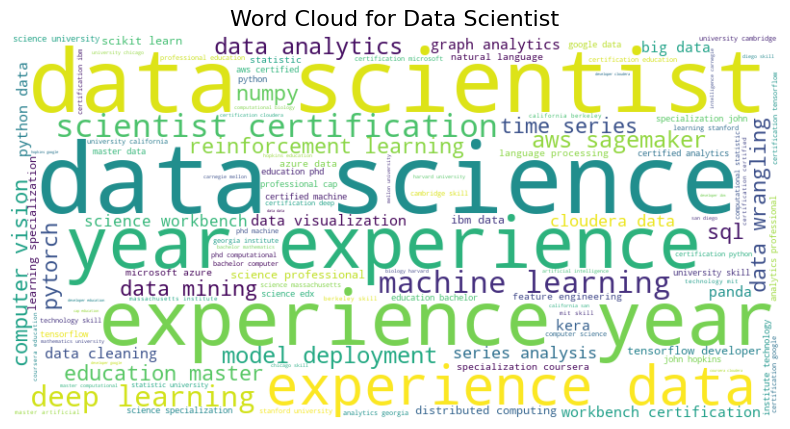

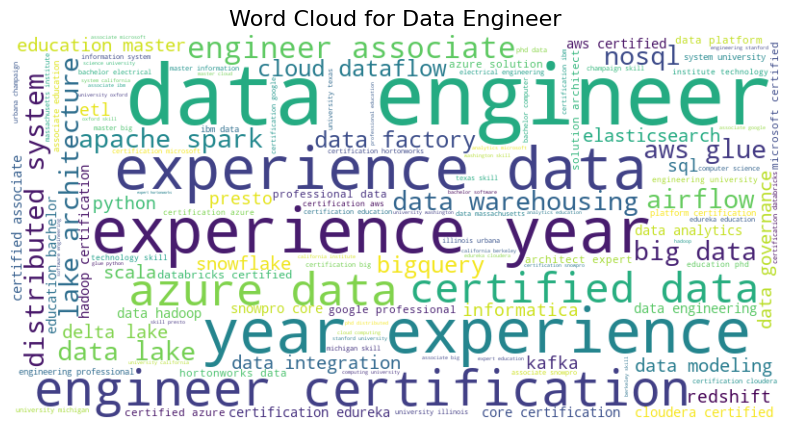

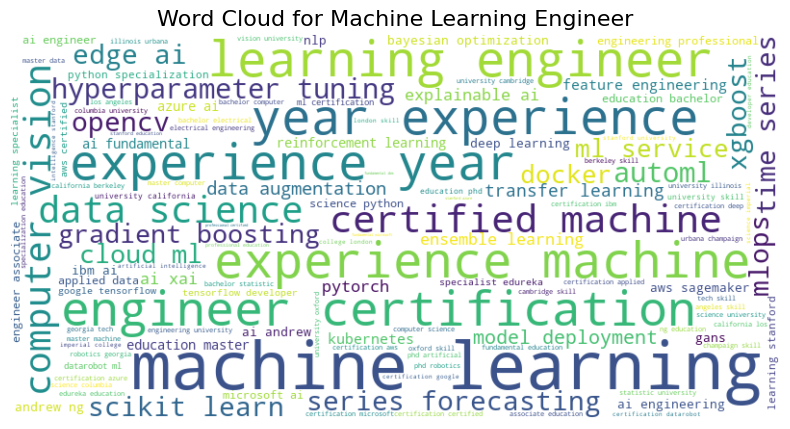

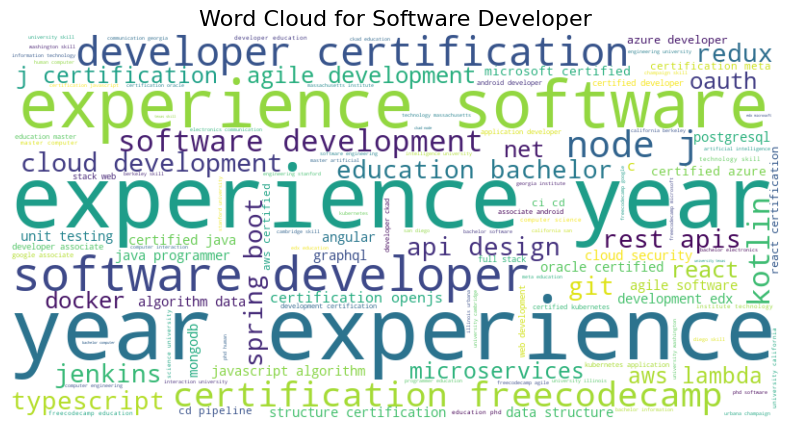

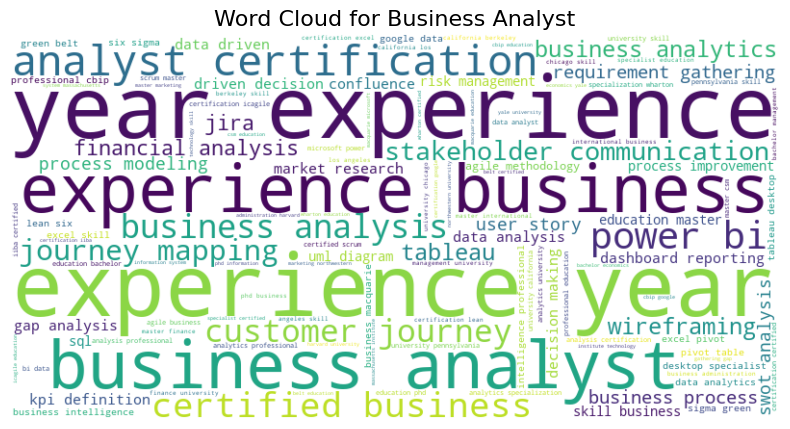

...

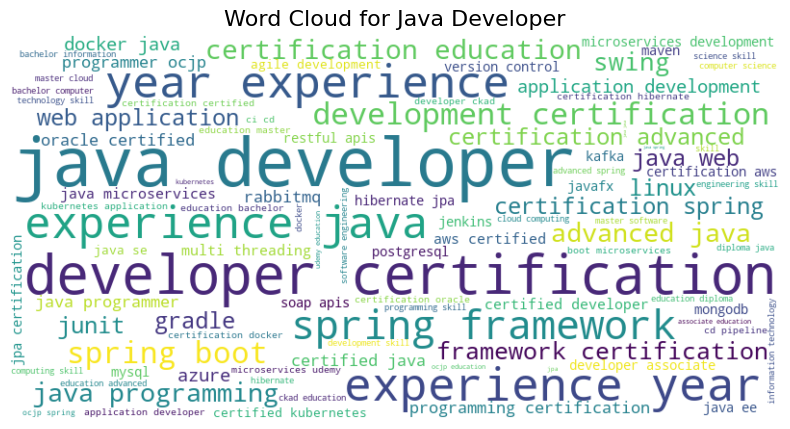

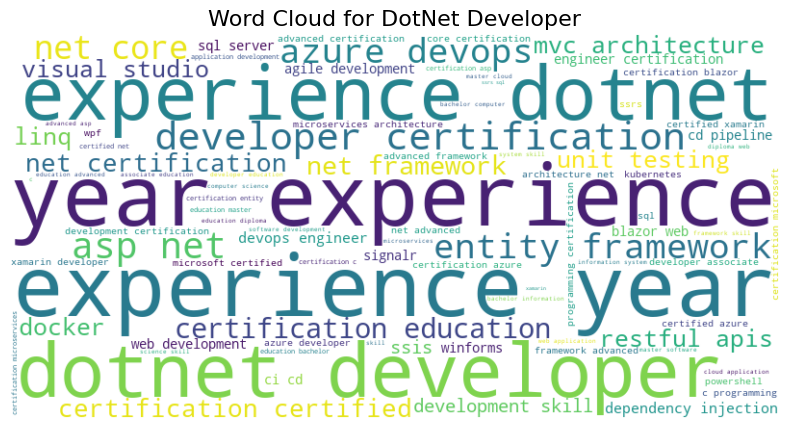

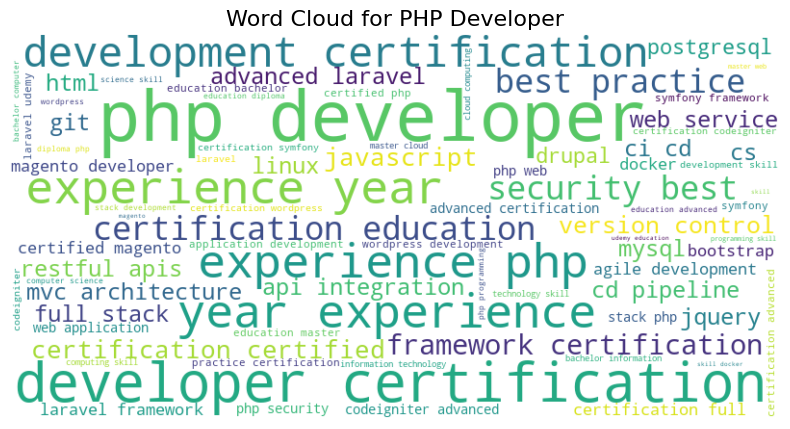

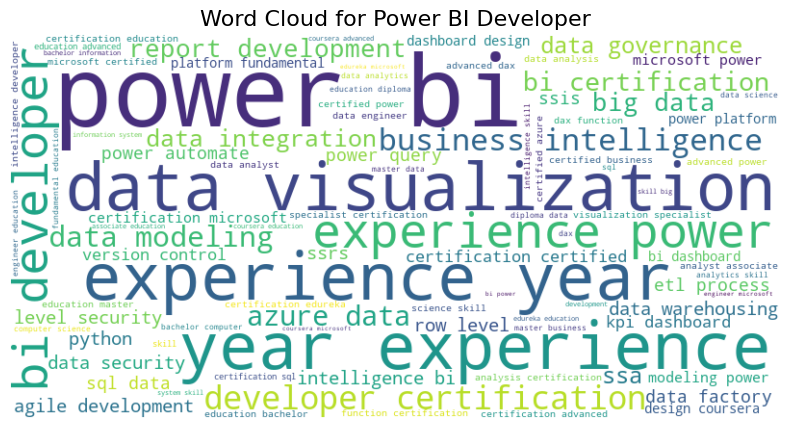

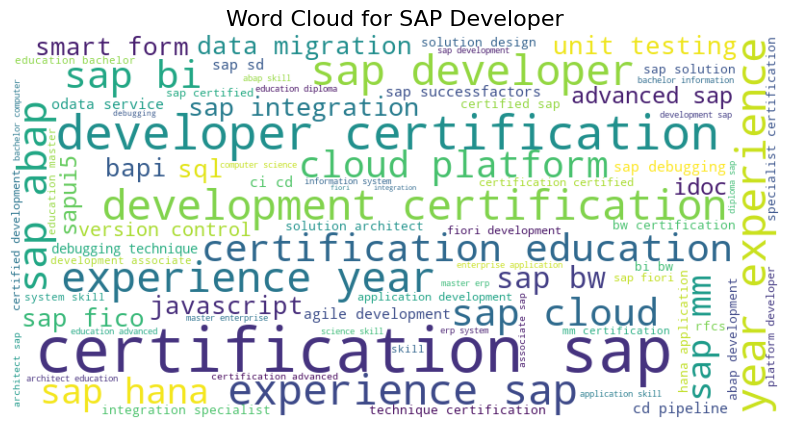

In [12]:
# Call the function to generate word clouds
generate_word_clouds_by_category(dataset, "Cleaned_Resume", "role")

In [13]:
# Prepare data
cleaned_resumes = dataset['Cleaned_Resume'].astype(str).apply(lambda x: x.split())  # Tokenized resumes
categories = dataset['role']

In [14]:
# Train-test split first
X_train, X_test, y_train, y_test = train_test_split(cleaned_resumes, categories, test_size=0.3, random_state=42)

In [15]:
X_train

3207    [education, ph, nursing, skill, iv, therapy, p...
3001    [education, master, science, biostatistics, sk...
2118    [education, bachelor, journalism, mass, commun...
6165    [education, diploma, biostatistics, skill, r, ...
6871    [education, bachelor, computer, science, skill...
                              ...                        
5734    [education, bachelor, operation, management, s...
5191    [education, bachelor, communication, skill, sa...
5390    [education, bachelor, political, science, skil...
860     [education, phd, computer, science, focus, sec...
7270    [education, master, software, engineering, ski...
Name: Cleaned_Resume, Length: 6195, dtype: object

In [16]:
y_train

3207                       Nurse
3001          Medical Researcher
2118              Content Writer
6165                Statistician
6871           Backend Developer
                  ...           
5734             Project Manager
5191             Sales Executive
5390                   Economist
860        Cybersecurity Analyst
7270    Test Automation Engineer
Name: role, Length: 6195, dtype: object

In [17]:
len(X_train), len(y_train)

(6195, 6195)

In [18]:
# Word2Vec model training
def train_word2vec_model(tokenized_texts, vector_size=100, window=5, min_count=2):
    model = Word2Vec(sentences=tokenized_texts, vector_size=vector_size, window=window, min_count=min_count, workers=4)
    return model

In [19]:
# Train Word2Vec model using the training data
word2vec_model = train_word2vec_model(X_train)

In [20]:
with open('word2vec_model.pkl', 'wb') as file:
    pickle.dump(word2vec_model, file)

In [21]:
# Convert the text data into a single numerical representation using Average Word2Vec
def avg_word2vec(word2vec_model, text):
    # If text is a list of words, join them into a single string
    if isinstance(text, list):
        text = ' '.join(text)

    # Tokenize the entire text
    tokens = word_tokenize(text)  # Tokenizing the entire resume text
    word_vectors = [word2vec_model.wv[word.lower()] for word in tokens if word.lower() in word2vec_model.wv]

    # If there are any word vectors, compute the mean
    if word_vectors:
        vector = np.mean(word_vectors, axis=0)  # Mean of word vectors
    else:
        vector = np.zeros(word2vec_model.vector_size)  # Zero vector if no words match

    return vector

In [22]:
# Vectorize both train and test data
X_train_vec = X_train.apply(lambda x: avg_word2vec(word2vec_model, x))  # Apply the function correctly

In [23]:
X_train_vec

3207    [-0.21582259, 0.48890522, -0.700866, -0.855391...
3001    [-0.077593975, 0.5948972, -0.8515836, -0.19114...
2118    [0.041690942, 0.79630804, 0.10923737, -0.48051...
6165    [-0.22137786, 0.30735296, -0.6251152, 0.189588...
6871    [-0.5755423, 0.38390517, -0.075296305, -0.1824...
                              ...                        
5734    [0.18969622, 0.33201957, -0.36603457, -0.35908...
5191    [-0.15012383, 0.368044, -0.42134154, -0.315626...
5390    [-0.13767356, 0.2645853, -0.7047399, 0.3767312...
860     [-0.2513551, 0.2821297, 0.20066859, 0.02055327...
7270    [-0.70545137, 0.24220105, 0.1417547, -0.314587...
Name: Cleaned_Resume, Length: 6195, dtype: object

In [24]:
# Encode target categories
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)  # Encoding train labels

In [25]:
y_train_encoded

array([38, 35, 10, ..., 19, 12, 56])

In [26]:
with open('label_encoder.pkl', 'wb') as file:
    pickle.dump(label_encoder, file)

In [27]:
# Convert the list of vectors into a 2D numpy array
X_train_vec_flattened = np.vstack(X_train_vec.values)

In [28]:
X_train_vec_flattened

array([[-0.21582259,  0.48890522, -0.700866  , ..., -0.10416937,
        -0.07148984, -0.26228243],
       [-0.07759397,  0.5948972 , -0.8515836 , ..., -0.02830395,
        -0.24598588, -0.14542161],
       [ 0.04169094,  0.79630804,  0.10923737, ..., -0.48368618,
        -0.7877154 , -0.42964083],
       ...,
       [-0.13767356,  0.2645853 , -0.7047399 , ..., -0.39891684,
         0.5927554 ,  0.32892397],
       [-0.2513551 ,  0.2821297 ,  0.20066859, ..., -0.94187456,
         0.24198952, -0.04877204],
       [-0.70545137,  0.24220105,  0.1417547 , ..., -0.09959982,
        -0.34279132,  0.0409689 ]], dtype=float32)

In [29]:
# Now train the RandomForest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train_vec_flattened, y_train_encoded)

RandomForestClassifier(random_state=42)

In [30]:
X_test_vec = X_test.apply(lambda x: avg_word2vec(word2vec_model, x))  # Apply the function correctly

In [31]:
y_test_encoded = label_encoder.transform(y_test)  # Encoding test labels

In [32]:
# Convert the list of vectors into a 2D numpy array
X_test_vec_flattened = np.vstack(X_test_vec.values)

In [33]:
# Make predictions on the test set
y_pred_encoded = rf_model.predict(X_test_vec_flattened)  # Predict encoded labels

In [34]:
y_pred_encoded

array([23, 54, 16, ..., 37, 14,  0])

In [35]:
# Convert predictions back to original categories
y_pred = label_encoder.inverse_transform(y_pred_encoded)  # Convert encoded predictions to original categories

In [36]:
y_pred

array(['Frontend Developer', 'Teacher', 'Database Administrator', ...,
       'Network Administrator', 'Data Engineer', 'AI Engineer'],
      dtype=object)

In [37]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)  # Compare original test labels with predicted ones
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

In [38]:
# Print evaluation metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Accuracy: 0.9989
Precision: 0.9989
Recall: 0.9989
F1 Score: 0.9989


In [39]:
with open('rf_model.pkl', 'wb') as file:
    pickle.dump(rf_model, file)

In [40]:
print(classification_report(y_test, y_pred))

                             precision    recall  f1-score   support

                AI Engineer       1.00      1.00      1.00        45
          Backend Developer       1.00      1.00      1.00        52
          Big Data Engineer       0.96      0.98      0.97        49
            Biotechnologist       1.00      1.00      1.00        43
       Blockchain Developer       1.00      1.00      1.00        46
           Business Analyst       1.00      1.00      1.00        47
          Chemical Engineer       1.00      1.00      1.00        50
             Civil Engineer       1.00      1.00      1.00        51
             Cloud Engineer       1.00      1.00      1.00        36
                 Consultant       1.00      1.00      1.00        42
             Content Writer       1.00      1.00      1.00        47
Customer Support Specialist       1.00      1.00      1.00        40
      Cybersecurity Analyst       1.00      1.00      1.00        43
               Data Analyst      